In [1]:
import pandas as pd 
import numpy as np


In [2]:
DATASET_COLUMNS=['target','ids','date','flag','user','text']
DATASET_ENCODING = "ISO-8859-1"
df = pd.read_csv(r"D:\python\Ml_datasets\twitter dataset.csv", encoding=DATASET_ENCODING, names=DATASET_COLUMNS)
df.sample(5)

,target,ids,date,flag,user,text
620144,0,2228225922,Thu Jun 18 14:10:30 PDT 2009,NO_QUERY,Ellyssa_Marie,@Locostambien thanks like .. i'm not a spoilt...
350192,0,2017603181,Wed Jun 03 08:39:31 PDT 2009,NO_QUERY,aprima,@phrensy omg!! the poor boy...
794254,0,2326920826,Thu Jun 25 07:41:08 PDT 2009,NO_QUERY,angelbaby38,Ay bay bay! I miss her http://mypict.me/5B4F
1028672,4,1932654616,Tue May 26 21:55:23 PDT 2009,NO_QUERY,YouLoveJackie,Is going to have a great day tomorrowwww. Ment...
1267415,4,1999839110,Mon Jun 01 20:55:08 PDT 2009,NO_QUERY,dancer2techie,@rainbowsoul your twitter made me really happy...


In [3]:
df.shape

(1600000, 6)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1600000 entries, 0 to 1599999
Data columns (total 6 columns):
 #   Column  Non-Null Count    Dtype 
---  ------  --------------    ----- 
 0   target  1600000 non-null  int64 
 1   ids     1600000 non-null  int64 
 2   date    1600000 non-null  object
 3   flag    1600000 non-null  object
 4   user    1600000 non-null  object
 5   text    1600000 non-null  object
dtypes: int64(2), object(4)
memory usage: 73.2+ MB


In [5]:
for col in df.columns:
    print(f"unique values for column: '{col}' ",df[col].unique() )

unique values for column: 'target'  [0 4]
unique values for column: 'ids'  [1467810369 1467810672 1467810917 ... 2193601991 2193602064 2193602129]
unique values for column: 'date'  ['Mon Apr 06 22:19:45 PDT 2009' 'Mon Apr 06 22:19:49 PDT 2009'
 'Mon Apr 06 22:19:53 PDT 2009' ... 'Tue Jun 16 08:38:58 PDT 2009'
 'Tue Jun 16 08:39:00 PDT 2009' 'Tue Jun 16 08:40:50 PDT 2009']
unique values for column: 'flag'  ['NO_QUERY']
unique values for column: 'user'  ['_TheSpecialOne_' 'scotthamilton' 'mattycus' ... 'EvolveTom'
 'AmandaMarie1028' 'bpbabe']
unique values for column: 'text'  ["@switchfoot http://twitpic.com/2y1zl - Awww, that's a bummer.  You shoulda got David Carr of Third Day to do it. ;D"
 "is upset that he can't update his Facebook by texting it... and might cry as a result  School today also. Blah!"
 '@Kenichan I dived many times for the ball. Managed to save 50%  The rest go out of bounds'
 ... 'Are you ready for your MoJo Makeover? Ask me for details '
 'Happy 38th Birthday to my

In [6]:
print("\n".join([
    f"number of unique values for column: '{col}' is {df[col].nunique()} \
and the values are {df[col].unique()}" 
    for col in df.columns
]))


number of unique values for column: 'target' is 2 and the values are [0 4]
number of unique values for column: 'ids' is 1598315 and the values are [1467810369 1467810672 1467810917 ... 2193601991 2193602064 2193602129]
number of unique values for column: 'date' is 774363 and the values are ['Mon Apr 06 22:19:45 PDT 2009' 'Mon Apr 06 22:19:49 PDT 2009'
 'Mon Apr 06 22:19:53 PDT 2009' ... 'Tue Jun 16 08:38:58 PDT 2009'
 'Tue Jun 16 08:39:00 PDT 2009' 'Tue Jun 16 08:40:50 PDT 2009']
number of unique values for column: 'flag' is 1 and the values are ['NO_QUERY']
number of unique values for column: 'user' is 659775 and the values are ['_TheSpecialOne_' 'scotthamilton' 'mattycus' ... 'EvolveTom'
 'AmandaMarie1028' 'bpbabe']
number of unique values for column: 'text' is 1581466 and the values are ["@switchfoot http://twitpic.com/2y1zl - Awww, that's a bummer.  You shoulda got David Carr of Third Day to do it. ;D"
 "is upset that he can't update his Facebook by texting it... and might cry as a

In [7]:
import plotly.express as px

target_dis_fig=px.histogram(df, x="target", nbins=30,title="Distribtion of Target")
target_dis_fig.show()

### Preprocessing the data

In [8]:
data=df[['text', 'target']]


In [9]:
data['target'].replace(4,1, inplace=True)

c:\python\lib\site-packages\pandas\core\series.py:4563: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [10]:
data.sample(5)

,text,target
922888,Happy Mother's Day to all the lucky ladies out...,1
474855,i think i'm over tweeting today just because ...,0
639637,@ddddaniela glad we got to hangziez b4 i leave...,0
723773,Calculated how much $ i'll have left to myself...,0
170376,i think i need a drink,0


In [11]:
###Making statement text in lowercase

data.loc[:, 'text'] = data.loc[:, 'text'] .str.lower()


c:\python\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [12]:
data['text'].sample(5)

981508     got a maths exam in a few hours. i'm still in ...
1160043    can't wait to tumblr! it is addicting. join no...
618601       r.i.p. kenny rankin. one of the greats ... sad 
657829     i want the 3gs so badly, but they'll be so exp...
469020     @joanneduran i'm sure ;) i used to live in wal...
Name: text, dtype: object

In [13]:
import nltk
nltk.download('stopwords')


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\dharm\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [14]:
from nltk.corpus import stopwords
stop_words=set(stopwords.words('english'))

In [15]:
print(stop_words)
print(f"Total number of stop words in english: {len(stop_words)}")

{'under', 'shan', 'is', "shan't", 'won', 'any', 'i', 'this', 'have', 'couldn', 'at', 'was', 'own', 'myself', 'can', 'don', 'why', 'too', 'o', 'me', 'nor', 've', 'a', 'doing', 'because', 'than', 'had', 'ma', 'off', 'my', 'each', "didn't", 'so', 'do', 'he', 'up', 'll', 's', 'been', 'as', "you'd", 'the', 'after', "should've", 'their', 'above', 'when', 'mustn', 'y', 'then', "couldn't", 'didn', 'over', 'an', 'if', 'same', "shouldn't", 'his', 'during', 'doesn', 'most', 'between', 'yourselves', 'into', 'it', 'some', 'wasn', "doesn't", 'ourselves', 'weren', 'its', 'who', 'other', "aren't", "you're", 'now', 'our', 'theirs', 'there', "needn't", 'aren', 'of', 'in', 'be', "wouldn't", 'isn', 'just', 'through', 'you', 'ain', 'until', 'wouldn', "haven't", 'such', 'or', 'should', 'hadn', 'what', 'yours', 'your', 'on', 'once', 'no', 'here', "isn't", "mustn't", 're', 'them', 'more', "it's", 'has', 'herself', 'd', "you'll", 'only', 'down', 'she', 'while', 'before', 'where', 'themselves', 'for', 'to', 'he

In [16]:

data.loc[:, 'text'] = data.loc[:, 'text'].apply(
                lambda x: ' '.join(word for word in x.split() if word not in stop_words)
    )

c:\python\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [17]:
data['text'].sample(5)

785510     trying sleep usual, wake 4 hours. house fumiga...
1046144    cara: im happy now...laying bed reading dougla...
1456272              seriously can't wait till june 15th (l)
1185092                                    loooooong weekend
428456                   heading north, rain seems following
Name: text, dtype: object

In [18]:
import string
def cleaning_punctuations(text):
    translator = str.maketrans('', '', string.punctuation)
    return text.translate(translator) 
data.loc[:, 'text']=data.loc[:, 'text'].apply(  
                             lambda x: cleaning_punctuations(x)                
                                              
                                              )

In [19]:
data['text'].sample(5)

1557674    httptwitpiccom7ic1r  friendsisters rockss love...
1473010                                   xxmisserinxx im up
733812                                          lit homework
843333     spicybev bird crazy one lol let free 2 times d...
1066900    notoriousflirt smart funny caring gorgeous boo...
Name: text, dtype: object

In [20]:
#5.11: Cleaning and removing repeating characters
import regex as re

def cleaning_repeating_char(text):
    return re.sub(r'(.)1+', r'1', text)
data['text'] = data['text'].apply(lambda x: cleaning_repeating_char(x))
data['text'].tail()

C:\Users\dharm\AppData\Local\Temp\ipykernel_23304\2327533978.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



1599995                     woke up school best feeling ever
1599996    thewdbcom  cool hear old walt interviews â« h...
1599997                      ready mojo makeover ask details
1599998    happy 38th birthday boo alll time tupac amaru ...
1599999    happy charitytuesday thenspcc sparkscharity sp...
Name: text, dtype: object

In [21]:
#5.12: Cleaning and removing URLs




def cleaning_URLs(data):
    return re.sub('((www.[^s]+)|(https?://[^s]+))',' ',data)
data['text'] = data['text'].apply(lambda x: cleaning_URLs(x))
data['text'].tail()

C:\Users\dharm\AppData\Local\Temp\ipykernel_23304\3699792911.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



1599995                     woke up school best feeling ever
1599996    thewdbcom  cool hear old walt interviews â« h...
1599997                      ready mojo makeover ask details
1599998    happy 38th birthday boo alll time tupac amaru ...
1599999    happy charitytuesday thenspcc sparkscharity sp...
Name: text, dtype: object

In [22]:
#5.13: Cleaning and removing numeric numbers
def cleaning_numbers(data):
    return re.sub('[0-9]+', '', data)
data['text'] = data['text'].apply(lambda x: cleaning_numbers(x))
data['text'].tail()


C:\Users\dharm\AppData\Local\Temp\ipykernel_23304\3256198385.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



1599995                     woke up school best feeling ever
1599996    thewdbcom  cool hear old walt interviews â« h...
1599997                      ready mojo makeover ask details
1599998    happy th birthday boo alll time tupac amaru sh...
1599999    happy charitytuesday thenspcc sparkscharity sp...
Name: text, dtype: object

In [23]:
import nltk
from nltk.tokenize import word_tokenize

nltk.download('punkt')

data['text'] = data['text'].apply(lambda x: word_tokenize(x))
data['text'].tail()

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\dharm\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
C:\Users\dharm\AppData\Local\Temp\ipykernel_23304\3209225995.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



1599995              [woke, up, school, best, feeling, ever]
1599996    [thewdbcom, cool, hear, old, walt, interviews,...
1599997                [ready, mojo, makeover, ask, details]
1599998    [happy, th, birthday, boo, alll, time, tupac, ...
1599999    [happy, charitytuesday, thenspcc, sparkscharit...
Name: text, dtype: object

In [24]:

###5.15: Applying stemming

st=nltk.PorterStemmer()

data['text'] = data['text'].apply(lambda x: [st.stem(word) for word in x])

data.sample(5)

C:\Users\dharm\AppData\Local\Temp\ipykernel_23304\590010380.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text,target
799460,"[twa, sad, sad, news, bout, farrahlet, pray, s...",0
930798,"[megatann, yeah, idki, hope, dont, see, bfd, a]",1
291730,"[away, watch, thursday, eastend, got, bit, cat...",0
647218,"[amedoow, salamat, salamat, aak, el, soo, sht,...",0
1358656,"[jacoutofthebox, xurxovid, hmm, voic, chang, d...",1


In [25]:
##5.16: Applying lemmatizer
nltk.download('wordnet')
lm= nltk.WordNetLemmatizer()

data['text']= data['text'].apply(lambda x : [lm.lemmatize(word) for word in x])

data.sample(5)

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\dharm\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
C:\Users\dharm\AppData\Local\Temp\ipykernel_23304\2731009803.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,text,target
62206,"[got, stung, bee, bad, time, well, bee, im, wo...",0
1037557,"[im, come, twitter, lol]",1
674194,"[geminitwist, joey, joe, griffin, stage, popsi...",0
737480,"[jahanazad, live, countri, look, iran, truli, ...",0
214417,"[iamthespid, ita, sick, week, ago, feel, you]",0


In [26]:
##Spliting the dataset

X=data.text
y=data.target



In [27]:
!pip install wordcloud


[notice] A new release of pip is available: 23.3.1 -> 23.3.2
[notice] To update, run: python.exe -m pip install --upgrade pip


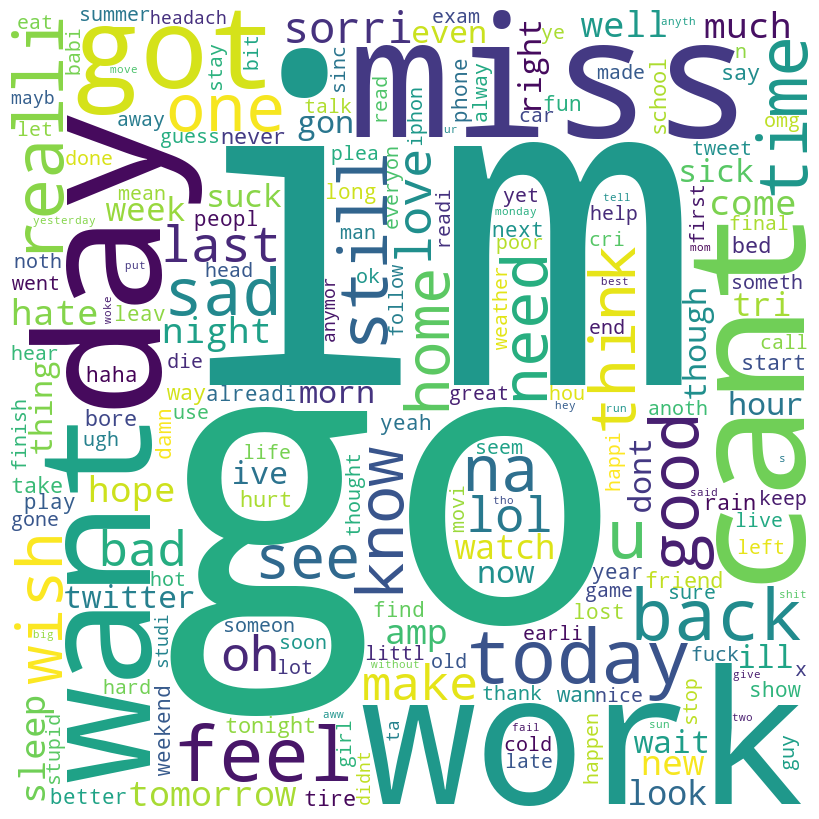

In [28]:
### forming a wordcloud of negative tweets 
from wordcloud import WordCloud
import matplotlib.pyplot as plt
neg_tweets=data[data['target']==0]
neg_tweets_str = ' '.join([' '.join(words) for words in neg_tweets['text']])

wordcloud = WordCloud(width=800, height=800, background_color='white', collocations=False, min_font_size=10).generate(neg_tweets_str)

# Display the generated image
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)

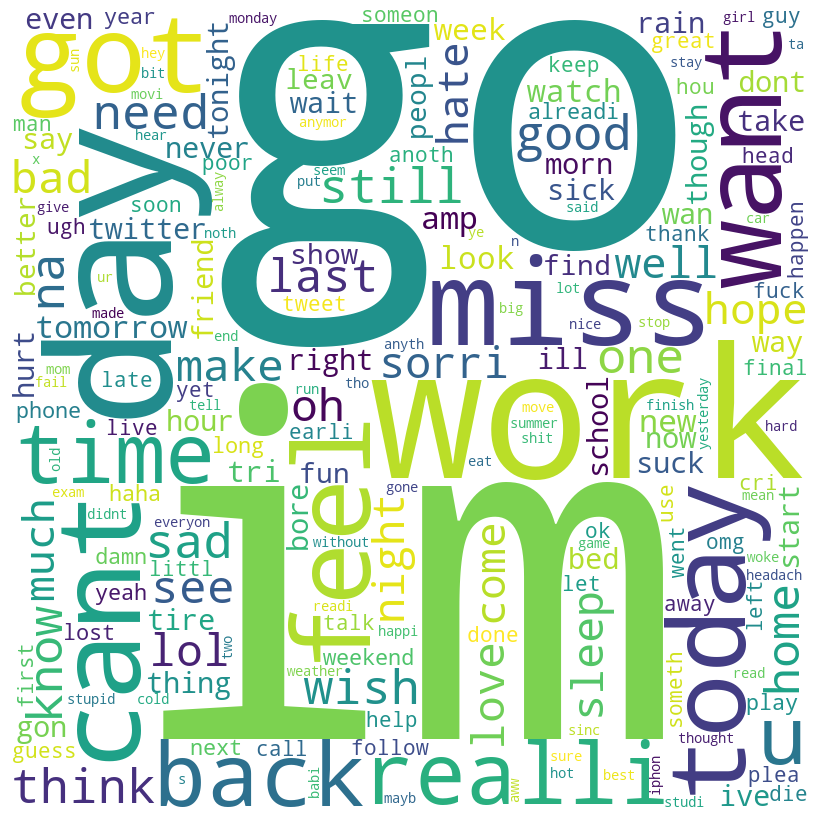

In [29]:
### forming a wordcloud of positive tweets 
from wordcloud import WordCloud,STOPWORDS
import matplotlib.pyplot as plt
pos_tweets=data[data['target']==1]
pos_tweets_str = ' '.join([' '.join(words) for words in pos_tweets['text']])

pos_wordcloud = WordCloud(width=800, height=800, background_color='white', 
                          stopwords = set(STOPWORDS),collocations=False, min_font_size=10).generate(neg_tweets_str)

# Display the generated image
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(pos_wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)

In [30]:
X=data.text
y=data.target

In [31]:
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import BernoulliNB
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import confusion_matrix, classification_report

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.20, random_state =26105111)


In [33]:
X_train = [" ".join(doc) if isinstance(doc, list) else doc for doc in X_train]
X_test = [" ".join(doc) if isinstance(doc, list) else doc for doc in X_test]


In [34]:
#Step-7: Transforming the Dataset Using TF-IDF Vectorizer
tf_idf_vectorizer=TfidfVectorizer(ngram_range=(1,2),max_features=500000)



In [35]:
X_train_vec= tf_idf_vectorizer.fit_transform(X_train)
X_test_vec= tf_idf_vectorizer.fit_transform(X_test)

In [36]:
import seaborn as sns


def model_evaluation(model):
    
    y_pred = model.predict(X_test_vec)
    print(classification_report(y_test,y_pred))
    
    cf_matrix=confusion_matrix(y_test,y_pred)
    categories = ['Negative','Positive']
    group_names = ['True Neg','False Pos', 'False Neg','True Pos']
    group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix.flatten() / np.sum(cf_matrix)]
    labels = [f'{v1}n{v2}' for v1, v2 in zip(group_names,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sns.heatmap(cf_matrix, annot = labels, cmap = 'Blues',fmt = '',
    xticklabels = categories, yticklabels = categories)
    plt.xlabel("Predicted values", fontdict = {'size':14}, labelpad = 10)
    plt.ylabel("Actual values" , fontdict = {'size':14}, labelpad = 10)
    plt.title ("Confusion Matrix", fontdict = {'size':18}, pad = 20)
    
    return y_pred
    



In [37]:
from sklearn.metrics import roc_curve, auc

def plot_roc_curve(y_pred1):
    fpr, tpr, thresholds = roc_curve(y_test, y_pred1)
    roc_auc = auc(fpr, tpr)
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=1, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC CURVE')
    plt.legend(loc="lower right")
    plt.show()

              precision    recall  f1-score   support

           0       0.51      0.48      0.49    159838
           1       0.51      0.53      0.52    160162

    accuracy                           0.51    320000
   macro avg       0.51      0.51      0.51    320000
weighted avg       0.51      0.51      0.51    320000



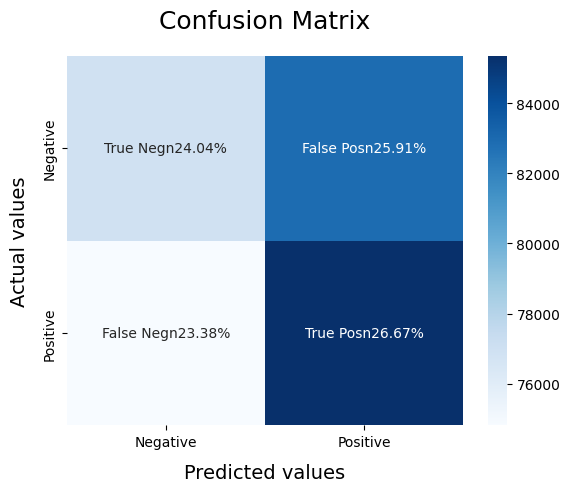

In [38]:
### Bernoulii Navie bayes
BNBmodel = BernoulliNB()
BNBmodel.fit(X_train_vec, y_train)
y_pred1=model_evaluation(BNBmodel)


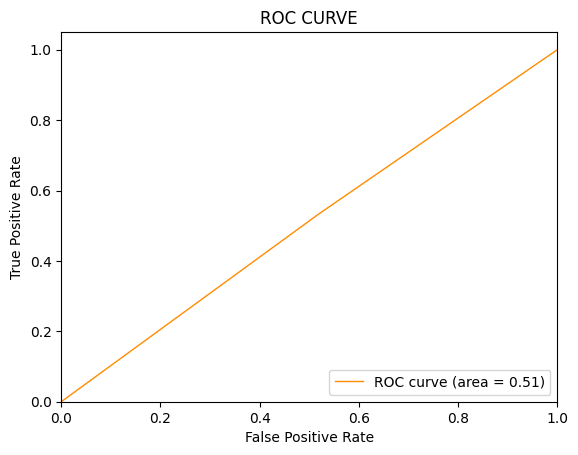

In [39]:
plot_roc_curve(y_pred1)

              precision    recall  f1-score   support

           0       0.50      0.43      0.46    159838
           1       0.50      0.56      0.53    160162

    accuracy                           0.50    320000
   macro avg       0.50      0.50      0.49    320000
weighted avg       0.50      0.50      0.49    320000



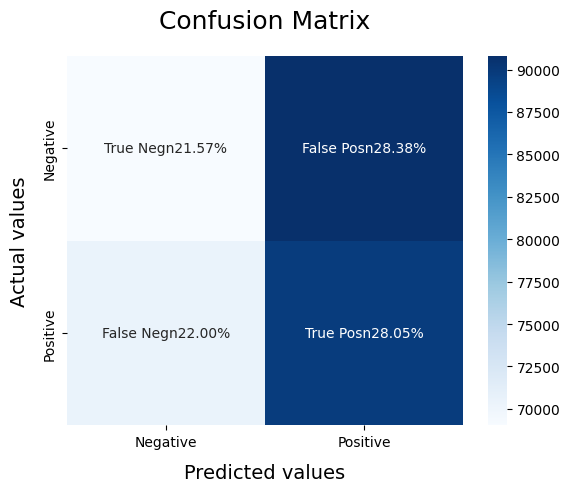

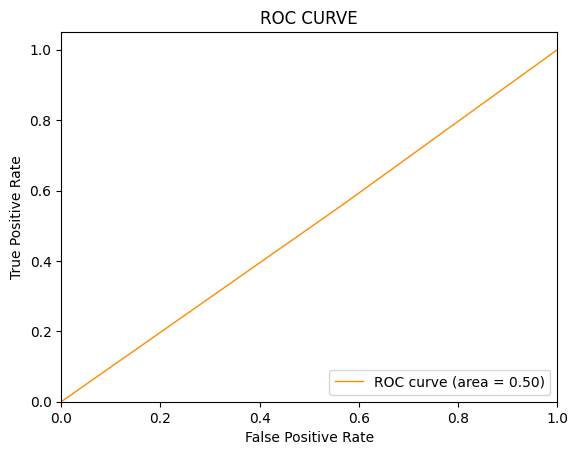

In [40]:
SVCmodel = LinearSVC()
SVCmodel.fit(X_train_vec, y_train)
y_pred2 = model_evaluation(SVCmodel)
plot_roc_curve(y_pred2)

              precision    recall  f1-score   support

           0       0.50      0.43      0.46    159838
           1       0.50      0.56      0.53    160162

    accuracy                           0.50    320000
   macro avg       0.50      0.50      0.49    320000
weighted avg       0.50      0.50      0.49    320000



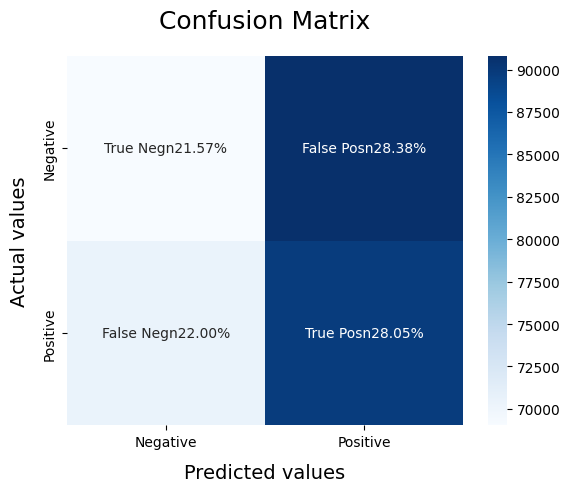

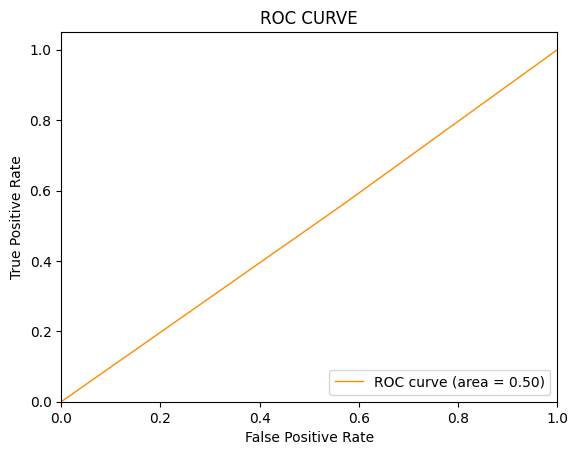

In [41]:
LRmodel = LogisticRegression(C = 2, max_iter = 1000, n_jobs=-1)

LRmodel.fit(X_train_vec, y_train)
y_pred3 = model_evaluation(SVCmodel)
plot_roc_curve(y_pred3)

In [42]:
X.head()

0    [switchfoot, httptwitpiccomzl, a, s, bummer, s...
1    [upset, cant, updat, facebook, text, it, might...
2    [kenichan, dive, mani, time, ball, manag, save...
3               [whole, bodi, feel, itchi, like, fire]
4    [nationwideclass, no, behav, all, im, mad, her...
Name: text, dtype: object

In [43]:
#### Buliding model using neural networks
import keras
from keras.preprocessing.text import Tokenizer
from keras.utils import pad_sequences
from keras.layers import Dense, Dropout, Embedding, LSTM, Bidirectional,InputLayer

In [44]:
max_vocab=50000
twitter_data_tokenizer=Tokenizer(num_words=max_vocab)
twitter_data_tokenizer.fit_on_texts(X_train)

In [45]:
X_train_seq= twitter_data_tokenizer.texts_to_sequences(X_train)
X_test_seq = twitter_data_tokenizer.texts_to_sequences(X_test)


In [46]:
max_len=max([len(x) for x in X_test_seq])

In [47]:
X_train_pad = pad_sequences(X_train_seq, maxlen=max_len)
X_test_pad = pad_sequences(X_test_seq, maxlen=max_len)

In [48]:
index  = 123  # index in range [0,1599999]

print('\nOriginal :')
print(df['text'][index])
print('\nTokenized :')
print(X[index])
print('\nVectorized :')
print(X_train_seq[index])
print('\nPadded :')
print(X_train_pad[index])


Original :
I am in pain. My back and sides hurt. Not to mention crying is made of fail. 

Tokenized :
['pain', 'back', 'side', 'hurt', 'mention', 'cri', 'made', 'fail']

Vectorized :
[38037, 98, 21, 2106, 1491, 591]

Padded :
[    0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0 38037
    98    21  2106  1491   591]


In [49]:
import torch

if torch.cuda.is_available():
    print(f"CUDA is available. Device: {torch.cuda.get_device_name(0)}")
else:
    print("CUDA is not available. Running on CPU.")


CUDA is available. Device: NVIDIA GeForce RTX 3060 Laptop GPU


In [50]:
type(y_test)

pandas.core.series.Series

In [51]:
##converting into tensor datasets for pytorch

import torch

# Assuming X_train_pad and X_test_pad are numpy arrays
X_train_tensor = torch.LongTensor(X_train_pad)
X_test_tensor = torch.LongTensor(X_test_pad)
y_test_np = y_test.to_numpy()  # Convert Series to NumPy array
y_test_tensor = torch.FloatTensor(y_test_np)  # Convert NumPy array to PyTorch tensor
y_train_np = y_train.to_numpy()
y_train_tensor = torch.FloatTensor(y_train_np)



In [52]:
from torch.utils.data import TensorDataset, DataLoader

train_data=TensorDataset(X_train_tensor,y_train_tensor)
test_data=TensorDataset(X_test_tensor, y_test_tensor)





In [57]:
torch.save(train_data, 'dataset/train_data.pt')
torch.save(test_data, 'dataset/test_data.pt')

In [54]:
# train_data_loaded = torch.load('train_data.pt')
# test_data_loaded = torch.load('test_data.pt')



batch_size = 32  # You can adjust this according to your needs

train_loader=DataLoader(train_data,shuffle=True,batch_size=batch_size)
test_loader=DataLoader(test_data,shuffle=True,batch_size=batch_size)

In [55]:
# torch.cuda.is_available() checks and returns a Boolean True if a GPU is available, else it'll return False
is_cuda = torch.cuda.is_available()

# If we have a GPU available, we'll set our device to GPU. We'll use this device variable later in our code.
if is_cuda:
    device = torch.device("cuda")
    print("GPU is available")
else:
    device = torch.device("cpu")
    print("GPU not available, CPU used")

GPU is available


In [87]:
import torch
import torch.nn as nn

class SimpleLSTM(nn.Module):
    
    def __init__ (self, vocab_size, embedding_dim, hidden_dim, output_dim,dropout_rate):
        super(SimpleLSTM, self).__init__()
        self.embedding = nn.Embedding(vocab_size, embedding_dim)
        self.dropout = nn.Dropout(dropout_rate)

        self.lstm=nn.LSTM(embedding_dim, hidden_dim, batch_first=True)
        self.fc=nn.Linear(hidden_dim,output_dim)
        
    
    def forward(self,x):
        
        embedded=self.embedding(x)
        output, (hidden, cell) =self.lstm(embedded)
        hidden=hidden.squeeze(0)
        hidden = self.dropout(hidden)  # Apply dropout to the output of LSTM

        out=self.fc(hidden)
        return out


vocab_size = max_vocab + 1  # +1 for padding token
embedding_dim = 100
hidden_dim = 256
output_dim = 1  # Binary classification

model = SimpleLSTM(vocab_size, embedding_dim, hidden_dim, output_dim,dropout_rate=0.5)
model = model.to(device) 
    

In [88]:
###Loss function

criterion = nn.BCEWithLogitsLoss().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)  # Example weight decay


In [82]:
###training

def train(model, iterator, optimizer, criterion, device):
    model.train()
    epoch_loss = 0

    for batch in iterator:
        optimizer.zero_grad()
        # Move batch to device
        #print(type(batch), batch)
        text, labels = batch
        text = text.to(device)
        labels = labels.to(device)
        predictions = model(text).squeeze(1)
        loss = criterion(predictions, labels)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

    return epoch_loss / len(iterator)

In [84]:
##evaluation
def evaluate(model, iterator, criterion, device):
    model.eval()
    epoch_loss = 0

    with torch.no_grad():
        for batch in iterator:
            # Move batch to device
            text, labels = batch
            text = text.to(device)
            labels = labels.to(device)
            predictions = model(text).squeeze(1)
            loss = criterion(predictions, labels)
            epoch_loss += loss.item()
    
    return epoch_loss / len(iterator)


In [89]:
num_epochs = 5

for epoch in range(num_epochs):
    train_loss = train(model, train_loader, optimizer, criterion,device)
    test_loss = evaluate(model, test_loader, criterion,device)
    print(f'Epoch: {epoch+1:02}, Train Loss: {train_loss:.3f}, Test Loss: {test_loss:.3f}')


Epoch: 01, Train Loss: 0.476, Test Loss: 0.460
Epoch: 02, Train Loss: 0.455, Test Loss: 0.452
Epoch: 03, Train Loss: 0.449, Test Loss: 0.449
Epoch: 04, Train Loss: 0.444, Test Loss: 0.445
Epoch: 05, Train Loss: 0.441, Test Loss: 0.446


In [90]:
import datetime
import torch

# Get the current time
current_time = datetime.datetime.now().strftime('%Y%m%d_%H%M%S')

# Create a filename with a timestamp
filename = "models/"+f'model_{current_time}.pth'

# Save the model state dictionary
torch.save(model.state_dict(), filename)
